<a href="https://colab.research.google.com/github/huzhangc/Image_Style_Transfer/blob/main/Real_Time_Transfer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



### 1. [Perceptual Losses for Real-Time Style Transfer and Super-Resolution (Johnson et al., 2016)](https://arxiv.org/pdf/1603.08155.pdf)


- Import libraries

In [ ]:
# Notebook display
from PIL import Image
from google.colab import files
import matplotlib.pyplot as plt
from IPython.display import clear_output
from tqdm.notebook import trange, tqdm_notebook

# PyTorch
import torch
from torch.optim import Adam
import torch.nn.functional as F
from torchvision import transforms
from torchvision.datasets import CocoDetection
from torch.hub import load_state_dict_from_url
from torch.utils.data import DataLoader, Dataset
from torch.nn import Module, Sequential, Upsample, ReflectionPad2d, Conv2d, InstanceNorm2d, ReLU, MaxPool2d

- Define constants and image processing functions

In [ ]:
# Image size
SIZE = 1280

# ImageNet statistics
MEAN = (0.485, 0.456, 0.406)
STD = (0.229, 0.224, 0.225)

# Determine device
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Pre-processing
def prep(image, size=SIZE, normalize=True, mean=MEAN, std=STD, device=DEVICE):
    resize = transforms.Compose([transforms.Resize(size, Image.LANCZOS),
                                 transforms.CenterCrop(size)])
    image = resize(image.convert('RGB'))
    if normalize:
        norm = transforms.Compose([transforms.ToTensor(),
                                   transforms.Normalize(mean, std)])
        return norm(image).unsqueeze(0).to(device)
    else:
        return image

# Post-processing
def post(tensor, mean=MEAN, std=STD):
    mean, std = torch.tensor(mean).view(3, 1, 1), torch.tensor(std).view(3, 1, 1)
    tensor = transforms.Lambda(lambda x: x * std + mean)(tensor.cpu().clone().squeeze(0))
    return transforms.ToPILImage()(tensor.clamp_(0, 1))

# Draw content, style and output images
def draw(input, content_image, style_image):
    output = post(input)

    clear_output(wait=True)
    plt.figure(figsize=(18, 6))

    ax1 = plt.subplot(1, 3, 1)
    ax1.imshow(prep(content_image, normalize=False))
    ax1.axis('off')
    ax1.set_title('Content Image')

    ax2 = plt.subplot(1, 3, 2)
    ax2.imshow(prep(style_image, normalize=False))
    ax2.axis('off')
    ax2.set_title('Style Image')

    ax3 = plt.subplot(1, 3, 3)
    ax3.imshow(output)
    ax3.axis('off')
    ax3.set_title('Output Image')

    plt.show()
    return output

- Upload content and style images

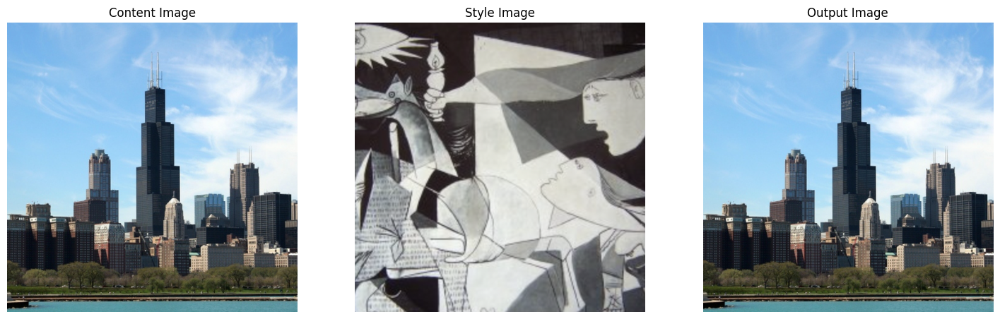

In [ ]:
# Manually upload images
files.upload()

# Open and prepare images
content_image, style_image = Image.open('city.jpeg'), Image.open('guernica.jpg')
content, style = prep(content_image), prep(style_image)

# Display images
_ = draw(content, content_image, style_image)

- Define content and style losses

In [ ]:
class ContentLoss(Module):
    def forward(self, features, targets):
        loss = F.mse_loss(features, targets)
        return loss


class StyleLoss(Module):
    def forward(self, features, GM_t):
        GM_f = self.gram_matrix(features)
        loss = F.mse_loss(GM_f, GM_t)
        return loss
    
    @staticmethod
    def gram_matrix(inputs):
        BS, C, H, W = inputs.size()
        inputs = inputs.view(BS, C, H * W)
        GM = inputs.bmm(inputs.transpose(1, 2))
        return GM.div_(C * H * W)

- Define Image Transformation Network with nearest neighbour upsampling, instead of transposed convolutions, for better performance

In [ ]:
class ConvBlock(Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride=1, upsample=False, norm=True, relu=True):
        super().__init__()

        self.upsample = Upsample(scale_factor=2) if upsample else None
        self.conv_block = Sequential(ReflectionPad2d(kernel_size // 2), Conv2d(in_channels, out_channels, kernel_size, stride))
        self.norm = InstanceNorm2d(out_channels, affine=True) if norm else None
        self.relu = ReLU(inplace=True) if relu else None

    def forward(self, x):
        if self.upsample:
            x = self.upsample(x)
        conv = self.conv_block(x)
        if self.norm:
            conv = self.norm(conv)
        if self.relu:
            conv = self.relu(conv)
        return conv


class ResBlock(Module):
    def __init__(self, channels):
        super().__init__()
        
        self.conv_blocks = Sequential(ConvBlock(channels, channels, kernel_size=3),
                                      ConvBlock(channels, channels, kernel_size=3, relu=False))

    def forward(self, x):
        return self.conv_blocks(x) + x


class ImageTransformationNetwork(Module):
    def __init__(self, num_res_blocks=5):
        super().__init__()

        self.transnet = Sequential(ConvBlock(3, 32, kernel_size=9, stride=1),
                                   ConvBlock(32, 64, kernel_size=3, stride=2),
                                   ConvBlock(64, 128, kernel_size=3, stride=2),
                                   *[ResBlock(128) for i in range(num_res_blocks)],
                                   ConvBlock(128, 64, kernel_size=3, upsample=True),
                                   ConvBlock(64, 32, kernel_size=3, upsample=True),
                                   ConvBlock(32, 3, kernel_size=9, norm=False, relu=False))

    def forward(self, x):
        return self.transnet(x)

- Define VGG-16

In [ ]:
class VGG16(Module):
    def __init__(self):
        super().__init__()

        # Feature Extractor
        self.conv1_1 = Conv2d(3, 64, kernel_size=3, padding=1)
        self.conv1_2 = Conv2d(64, 64, kernel_size=3, padding=1)
        self.pool1 =   MaxPool2d(kernel_size=2, stride=2)
            
        self.conv2_1 = Conv2d(64, 128, kernel_size=3, padding=1)
        self.conv2_2 = Conv2d(128, 128, kernel_size=3, padding=1)
        self.pool2 =   MaxPool2d(kernel_size=2, stride=2)
            
        self.conv3_1 = Conv2d(128, 256, kernel_size=3, padding=1)
        self.conv3_2 = Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv3_3 = Conv2d(256, 256, kernel_size=3, padding=1)
        self.pool3 =   MaxPool2d(kernel_size=2, stride=2)
            
        self.conv4_1 = Conv2d(256, 512, kernel_size=3, padding=1)
        self.conv4_2 = Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv4_3 = Conv2d(512, 512, kernel_size=3, padding=1)
        self.pool4 =   MaxPool2d(kernel_size=2, stride=2)
            
        self.conv5_1 = Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_2 = Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_3 = Conv2d(512, 512, kernel_size=3, padding=1)
        self.pool5 =   MaxPool2d(kernel_size=2, stride=2)
        
        # Freeze Parameters
        for param in self.parameters():
            param.requires_grad = False

    def forward(self, x, out_layers):
        out = dict()
        
        out['conv1_1'] = F.relu(self.conv1_1(x))
        out['conv1_2'] = F.relu(self.conv1_2(out['conv1_1']))
        out['pool1'] = self.pool1(out['conv1_2'])

        out['conv2_1'] = F.relu(self.conv2_1(out['pool1']))
        out['conv2_2'] = F.relu(self.conv2_2(out['conv2_1']))
        out['pool2'] = self.pool2(out['conv2_2'])

        out['conv3_1'] = F.relu(self.conv3_1(out['pool2']))
        out['conv3_2'] = F.relu(self.conv3_2(out['conv3_1']))
        out['conv3_3'] = F.relu(self.conv3_3(out['conv3_2']))
        out['pool3'] = self.pool3(out['conv3_3'])

        out['conv4_1'] = F.relu(self.conv4_1(out['pool3']))
        out['conv4_2'] = F.relu(self.conv4_2(out['conv4_1']))
        out['conv4_3'] = F.relu(self.conv4_3(out['conv4_2']))
        out['pool4'] = self.pool4(out['conv4_3'])

        out['conv5_1'] = F.relu(self.conv5_1(out['pool4']))
        out['conv5_2'] = F.relu(self.conv5_2(out['conv5_1']))
        out['conv5_3'] = F.relu(self.conv5_3(out['conv5_2']))
        out['pool5'] = self.pool5(out['conv5_3'])

        return [out[layer] for layer in out_layers]

- Initialize networks and load VGG-16 pre-trained weights & biases

In [ ]:
vgg16 = VGG16().to(DEVICE)
transnet = ImageTransformationNetwork().to(DEVICE)

state = vgg16.state_dict()
pretrained_vgg16 = 'https://download.pytorch.org/models/vgg16-397923af.pth'
new_state_values = list(load_state_dict_from_url(pretrained_vgg16).values())

for i, key in enumerate(state):
    state[key] = new_state_values[i]

vgg16.load_state_dict(state)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 256MB/s]


<All keys matched successfully>

### Training stage (skip if you have pre-trained weights)

- Load MS-COCO 2014 Train Dataset

In [ ]:
!wget http://images.cocodataset.org/annotations/annotations_trainval2014.zip
!wget http://images.cocodataset.org/zips/train2014.zip
!unzip annotations_trainval2014
!unzip train2014

image2tensor = transforms.Compose([transforms.Resize(256, Image.LANCZOS),
                                   transforms.CenterCrop(256),
                                   transforms.ToTensor(),
                                   transforms.Normalize(MEAN, STD)])

train_dataset = CocoDetection('train2014', 'annotations/instances_train2014.json', image2tensor)
train_loader = DataLoader(train_dataset, batch_size=4, collate_fn=lambda batch: torch.stack([x[0] for x in batch]))
clear_output()

- Pre-compute targets and initialize losses

In [ ]:
# Layers of content/style reconstruction
content_layers = ['conv2_2']
style_layers = ['conv1_2', 'conv2_2', 'conv3_3', 'conv4_3']
num_style_layers = len(style_layers)

# Style targets
style_tensors = style.repeat(4, 1, 1, 1)
style_targets = [StyleLoss.gram_matrix(target) for target in vgg16(style_tensors, style_layers)]

# Loss functions
content_loss_fn = ContentLoss()
style_loss_fn = StyleLoss()

# Loss weights
CONTENT_WEIGHT = 1
STYLE_WEIGHT = 1e5
TV_WEIGHT = 1e-6

In [ ]:
%%time

def transfer_style(transnet, content):
    transnet.eval()
    with torch.no_grad():
        output = draw(transnet(content), content_image, style_image)
    return output

CPU times: user 6 µs, sys: 0 ns, total: 6 µs
Wall time: 10.3 µs


- Train ImageTransformationNetwork on the chosen style

In [ ]:
def train(transnet, train_loader, style_targets, content_loss_fn, style_loss_fn, epochs=2,count=0):
    num_batches = len(train_loader)
    optimizer = Adam(transnet.parameters(), lr=1e-3)
    file_path_pattern = 'model_trail_{}.pth'
    l_content_loss = []
    l_style_loss = []
    l_tv_reg_loss = []
    l_total_loss = []
    output=[]
        

    for epoch in trange(epochs, desc='Epochs'):
        batches = iter(train_loader)
        # New variables to track epoch-wise loss
        epoch_content_loss = 0.0
        epoch_style_loss = 0.0
        epoch_tv_reg_loss = 0.0
        epoch_total_loss = 0.0
        
        # Reset epoch-wise loss variables at the beginning of each epoch
        epoch_batches = 0
        for batch_idx in tqdm_notebook(range(1, num_batches + 1), desc='Batches', leave=False):
            batch = next(batches).to(DEVICE)
            images_in_batch = len(batch)

            optimizer.zero_grad()
            vgg16_out = vgg16(batch, content_layers)
            transnet_out = transnet(batch)
            vgg16_transnet_out = vgg16(transnet_out, style_layers)

            # Content Loss
            content_preds, content_targets = vgg16_transnet_out[1], vgg16_out[0]
            content_loss = CONTENT_WEIGHT * content_loss_fn(content_preds, content_targets)
            
            # Adding batch loss to epoch-wise loss variable
            epoch_content_loss += content_loss.item()

            # Style Loss
            style_loss = 0
            for i in range(num_style_layers):
                style_loss += style_loss_fn(vgg16_transnet_out[i], style_targets[i][:images_in_batch])
            style_loss *= STYLE_WEIGHT
            # Adding batch loss to epoch-wise loss variable
            epoch_style_loss += style_loss.item()
            
            # Total Variation Regularization
            diff_i = ((transnet_out[:, :, :, 1:] - transnet_out[:, :, :, :-1]).abs()).sum()
            diff_j = ((transnet_out[:, :, 1:, :] - transnet_out[:, :, :-1, :]).abs()).sum()
            tv_reg = TV_WEIGHT * (diff_i + diff_j)
            # Adding batch loss to epoch-wise loss variable
            epoch_tv_reg_loss += tv_reg.item()


            total_loss = style_loss + content_loss + tv_reg
            # Adding batch loss to epoch-wise loss variable
            epoch_total_loss += total_loss.item()
            total_loss.backward()
            optimizer.step()

            epoch_batches += 1
        transnet.eval()
        output.append(transnet(content))
        transnet.train()
        #output = transfer_style(transnet, content)
        l_content_loss.append(epoch_content_loss/epoch_batches)
        l_style_loss.append(epoch_style_loss/epoch_batches)
        l_tv_reg_loss.append(epoch_tv_reg_loss/epoch_batches)
        l_total_loss.append(epoch_total_loss/epoch_batches)

        print(f'Epoch {epoch+1}: Content Loss: {epoch_content_loss/epoch_batches:.4f}, Style Loss: {epoch_style_loss/epoch_batches:.4f}, TV Reg Loss: {epoch_tv_reg_loss/epoch_batches:.4f}, Total Loss: {epoch_total_loss/epoch_batches:.4f}')
        #torch.save(transnet.state_dict(), 'starry_night.pth')
        #file_path = file_path_pattern.format(epoch)
        #torch.save(transnet.state_dict(), file_path)
    # Save the trained weights
    file_path = file_path_pattern.format(count)
    torch.save(transnet.state_dict(), file_path)

# Run
#train(transnet, train_loader, style_targets, content_loss_fn, style_loss_fn,epochs=5)

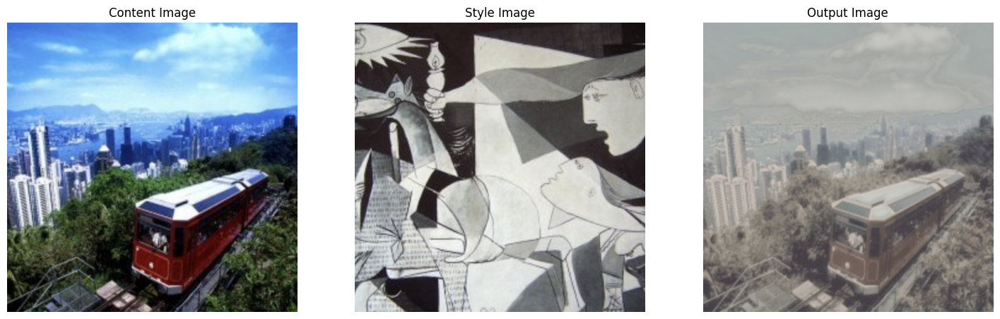

In [ ]:

transnet.load_state_dict(torch.load('model_epoch_0.pth'))
output = transfer_style(transnet, content)

In [ ]:
transnet.train()
# Load the saved weights,
transnet.load_state_dict(torch.load('starry_night.pth'))

# Continue training
train(transnet, train_loader, style_targets, content_loss_fn, style_loss_fn, epochs=1)

Epochs:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/20696 [00:00<?, ?it/s]

Epoch 1: Content Loss: 3.1539, Style Loss: 1.0731, TV Reg Loss: 0.0903, Total Loss: 4.3173


In [ ]:
import itertools
# reasonable values for style_weight
style_weight = [1e5,1,1e-2]
# reasonable values for content_weight
content_weight = [1,1e5,1e-2]

import pandas as pd

df = pd.DataFrame(columns=['style_weight', 'content_weight', 'total_variation_weight', 'loss', 'time'])

count = 1
for style_weight,content_weight in itertools.product(style_weight, content_weight):
  CONTENT_WEIGHT = content_weight
  STYLE_WEIGHT = style_weight
  print("This is trial:", count)
  print("style_weight: ",style_weight)
  print("content_weight",content_weight)
  transnet = ImageTransformationNetwork().to(DEVICE)
  train(transnet, train_loader, style_targets, content_loss_fn, style_loss_fn, epochs=1,count=count)
  count+=1

This is trial: 1
style_weight:  100000.0
content_weight 1


Epochs:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/20696 [00:00<?, ?it/s]

Epoch 1: Content Loss: 4.8058, Style Loss: 2.3121, TV Reg Loss: 0.0606, Total Loss: 7.1785
This is trial: 2
style_weight:  100000.0
content_weight 100000.0


Epochs:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/20696 [00:00<?, ?it/s]

Epoch 1: Content Loss: 78816.0413, Style Loss: 33.0511, TV Reg Loss: 0.2570, Total Loss: 78849.3494
This is trial: 3
style_weight:  100000.0
content_weight 0.01


Epochs:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/20696 [00:00<?, ?it/s]

Epoch 1: Content Loss: 0.0708, Style Loss: 2.7221, TV Reg Loss: 0.0423, Total Loss: 2.8351
This is trial: 4
style_weight:  1
content_weight 1


Epochs:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/20696 [00:00<?, ?it/s]

Epoch 1: Content Loss: 0.8245, Style Loss: 0.0003, TV Reg Loss: 0.2217, Total Loss: 1.0465
This is trial: 5
style_weight:  1
content_weight 100000.0


Epochs:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/20696 [00:00<?, ?it/s]

Epoch 1: Content Loss: 80097.1139, Style Loss: 0.0003, TV Reg Loss: 0.2569, Total Loss: 80097.3707
This is trial: 6
style_weight:  1
content_weight 0.01


Epochs:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/20696 [00:00<?, ?it/s]

Epoch 1: Content Loss: 0.0669, Style Loss: 0.0000, TV Reg Loss: 0.0001, Total Loss: 0.0670
This is trial: 7
style_weight:  0.01
content_weight 1


Epochs:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/20696 [00:00<?, ?it/s]

Epoch 1: Content Loss: 0.7478, Style Loss: 0.0000, TV Reg Loss: 0.2233, Total Loss: 0.9711
This is trial: 8
style_weight:  0.01
content_weight 100000.0


Epochs:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/20696 [00:00<?, ?it/s]

Epoch 1: Content Loss: 78055.8472, Style Loss: 0.0000, TV Reg Loss: 0.2575, Total Loss: 78056.1047
This is trial: 9
style_weight:  0.01
content_weight 0.01


Epochs:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/20696 [00:00<?, ?it/s]

Epoch 1: Content Loss: 0.0669, Style Loss: 0.0000, TV Reg Loss: 0.0001, Total Loss: 0.0670


### Inference step

- Transfer style

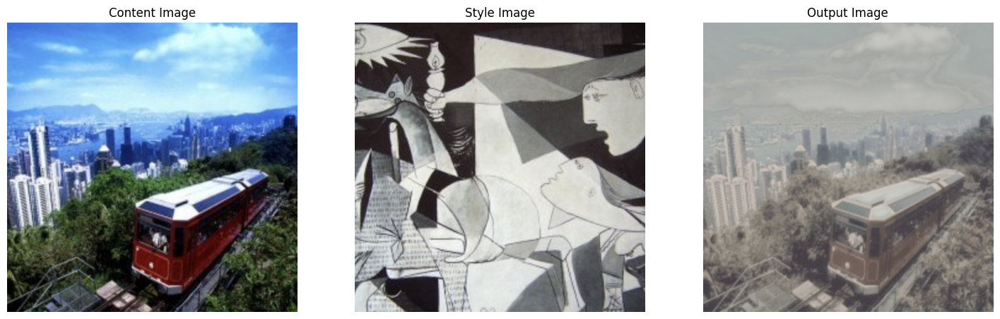

CPU times: user 1.3 s, sys: 229 ms, total: 1.53 s
Wall time: 1.22 s


In [ ]:
%%time
# Run
transnet.load_state_dict(torch.load('model_epoch_0.pth'))
output = transfer_style(transnet, content)

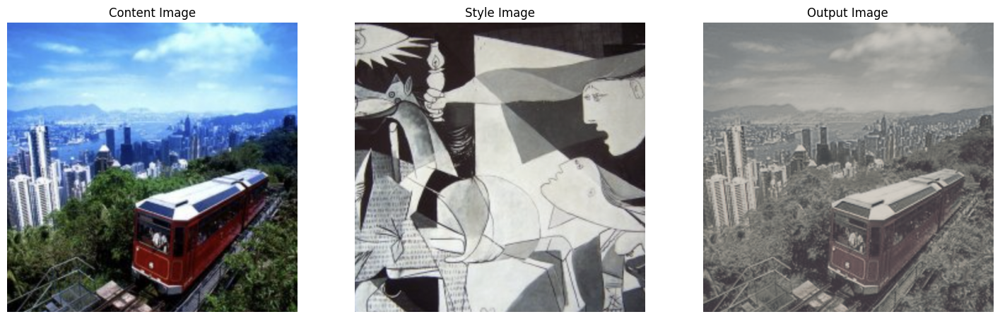

CPU times: user 1.32 s, sys: 229 ms, total: 1.55 s
Wall time: 1.23 s


In [ ]:
%%time
transnet.load_state_dict(torch.load('model_epoch_1.pth'))
output = transfer_style(transnet, content)

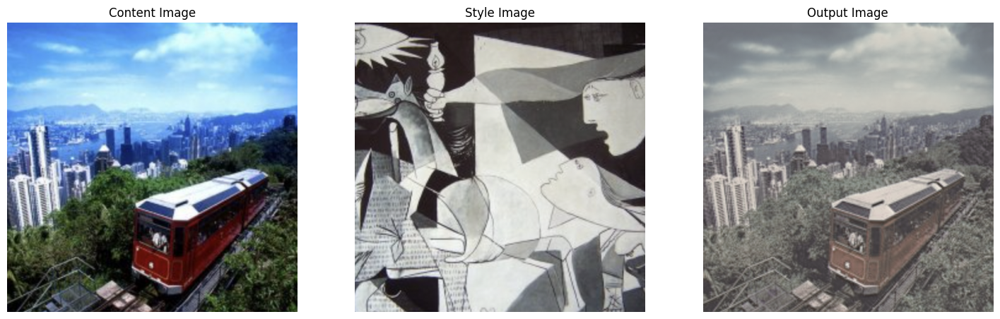

CPU times: user 1.32 s, sys: 234 ms, total: 1.55 s
Wall time: 1.24 s


In [ ]:
%%time
transnet.load_state_dict(torch.load('model_epoch_2.pth'))
output = transfer_style(transnet, content)

- Save and download output

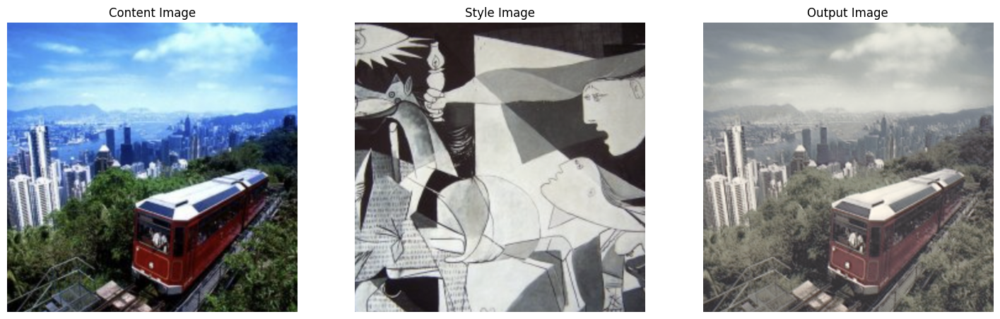

CPU times: user 1.34 s, sys: 261 ms, total: 1.6 s
Wall time: 1.26 s


In [ ]:
%%time
transnet.load_state_dict(torch.load('model_epoch_3.pth'))
output = transfer_style(transnet, content)

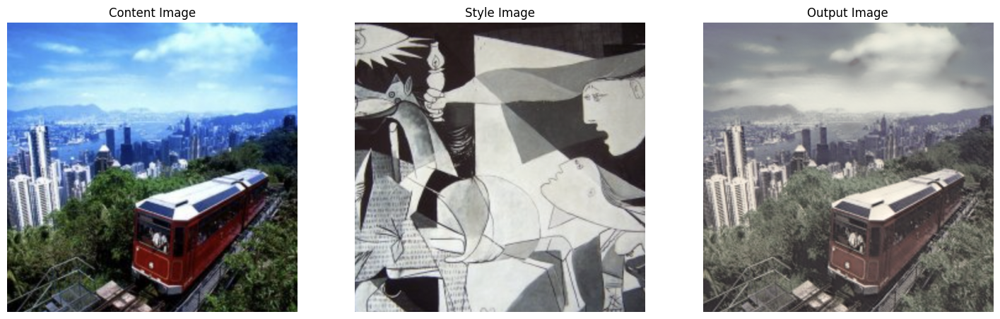

In [ ]:
transnet.load_state_dict(torch.load('model_epoch_4.pth'))
output = transfer_style(transnet, content)

In [ ]:
import pandas as pd

data = [
    [1, 100000.0, 1, 4.8058, 2.3121, 0.0606, 7.1785],
    [2, 100000.0, 100000.0, 78816.0413, 33.0511, 0.2570, 78849.3494],
    [3, 100000.0, 0.01, 0.0708, 2.7221, 0.0423, 2.8351],
    [4, 1, 1, 0.8245, 0.0003, 0.2217, 1.0465],
    [5, 1, 100000.0, 80097.1139, 0.0003, 0.2569, 80097.3707],
    [6, 1, 0.01, 0.0669, 0.0000, 0.0001, 0.0670],
    [7, 0.01, 1, 0.7478, 0.0000, 0.2233, 0.9711],
    [8, 0.01, 100000.0, 78055.8472, 0.0000, 0.2575, 78056.1047],
    [9, 0.01, 0.01, 0.0669, 0.0000, 0.0001, 0.0670]
]

columns = [
    "Trial Number",
    "Style Weight",
    "Content Weight",
    "Content Loss",
    "Style Loss",
    "TV Reg Loss",
    "Total Loss"
]

df = pd.DataFrame(data, columns=columns)

In [ ]:
df

,Trial Number,Style Weight,Content Weight,Content Loss,Style Loss,TV Reg Loss,Total Loss
0,1,100000.00,1.00,4.8058,2.3121,0.0606,7.1785
1,2,100000.00,100000.00,78816.0413,33.0511,0.2570,78849.3494
2,3,100000.00,0.01,0.0708,2.7221,0.0423,2.8351
3,4,1.00,1.00,0.8245,0.0003,0.2217,1.0465
4,5,1.00,100000.00,80097.1139,0.0003,0.2569,80097.3707
5,6,1.00,0.01,0.0669,0.0000,0.0001,0.0670
6,7,0.01,1.00,0.7478,0.0000,0.2233,0.9711
7,8,0.01,100000.00,78055.8472,0.0000,0.2575,78056.1047
8,9,0.01,0.01,0.0669,0.0000,0.0001,0.0670


In [ ]:
df_sorted = df.sort_values(by='Total Loss')

df_sorted

,Trial Number,Style Weight,Content Weight,Content Loss,Style Loss,TV Reg Loss,Total Loss
5,6,1.00,0.01,0.0669,0.0000,0.0001,0.0670
8,9,0.01,0.01,0.0669,0.0000,0.0001,0.0670
6,7,0.01,1.00,0.7478,0.0000,0.2233,0.9711
3,4,1.00,1.00,0.8245,0.0003,0.2217,1.0465
2,3,100000.00,0.01,0.0708,2.7221,0.0423,2.8351
0,1,100000.00,1.00,4.8058,2.3121,0.0606,7.1785
7,8,0.01,100000.00,78055.8472,0.0000,0.2575,78056.1047
1,2,100000.00,100000.00,78816.0413,33.0511,0.2570,78849.3494
4,5,1.00,100000.00,80097.1139,0.0003,0.2569,80097.3707


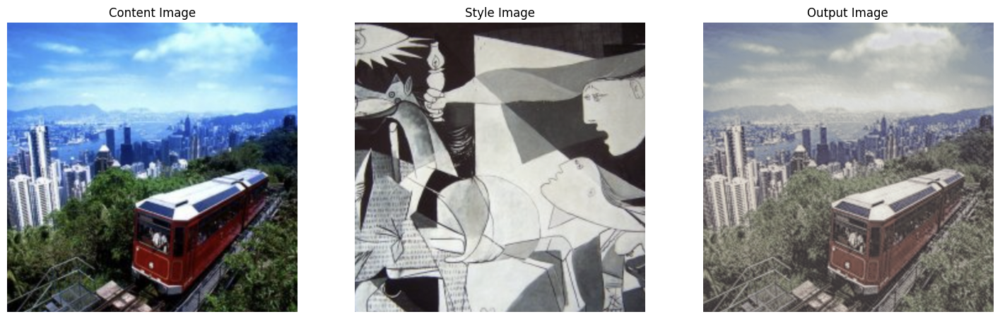

In [ ]:
transnet.load_state_dict(torch.load('model_trail_1.pth'))
output = transfer_style(transnet, content)

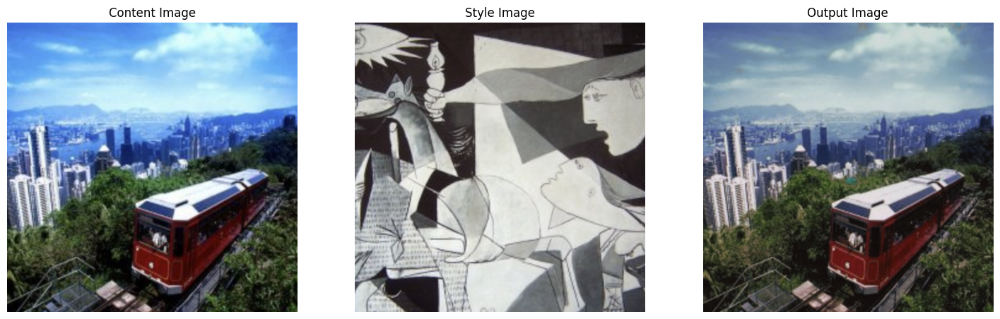

In [ ]:
transnet.load_state_dict(torch.load('model_trail_2.pth'))
output = transfer_style(transnet, content)

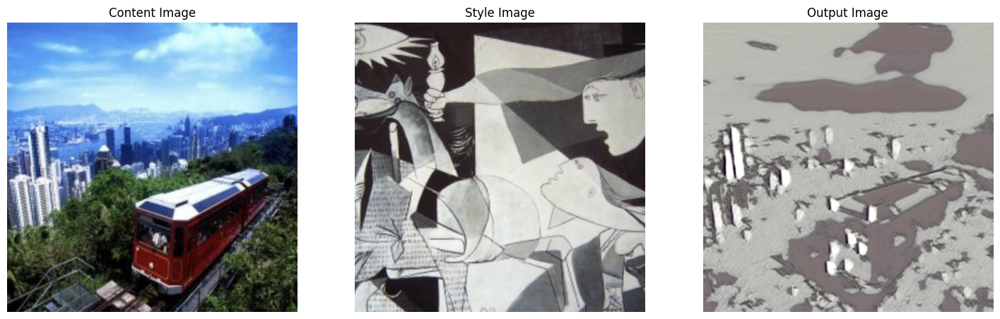

In [ ]:
transnet.load_state_dict(torch.load('model_trail_3.pth'))
output = transfer_style(transnet, content)

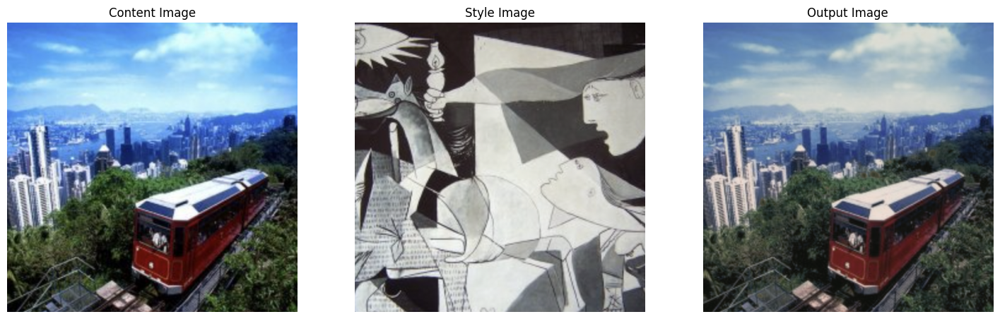

In [ ]:
transnet.load_state_dict(torch.load('model_trail_4.pth'))
output = transfer_style(transnet, content)

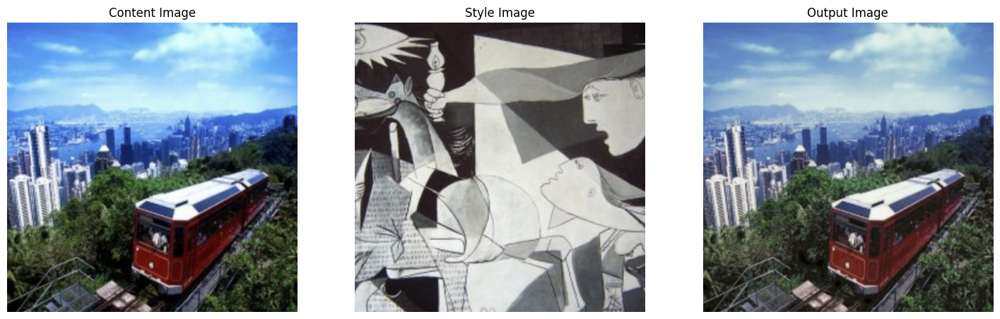

In [ ]:
transnet.load_state_dict(torch.load('model_trail_5.pth'))
output = transfer_style(transnet, content)

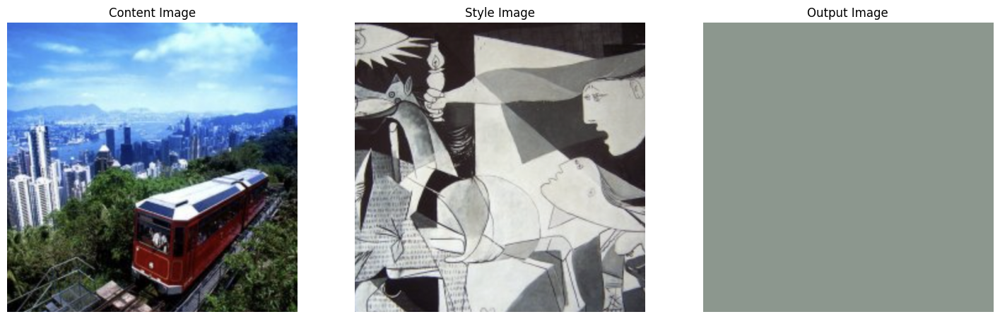

In [ ]:
transnet.load_state_dict(torch.load('model_trail_6.pth'))
output = transfer_style(transnet, content)

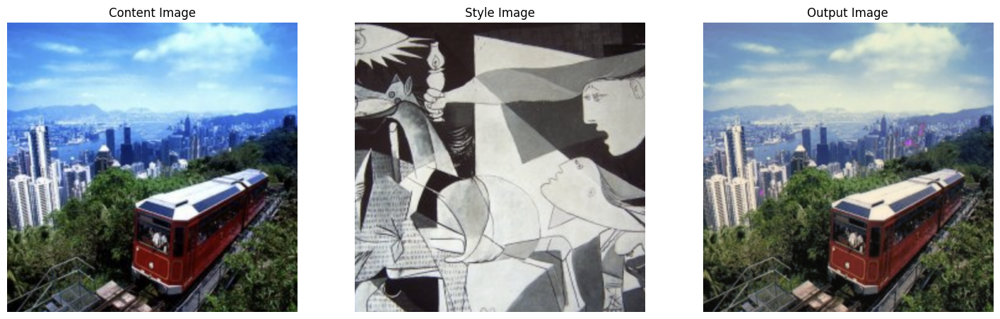

In [ ]:
transnet.load_state_dict(torch.load('model_trail_7.pth'))
output = transfer_style(transnet, content)

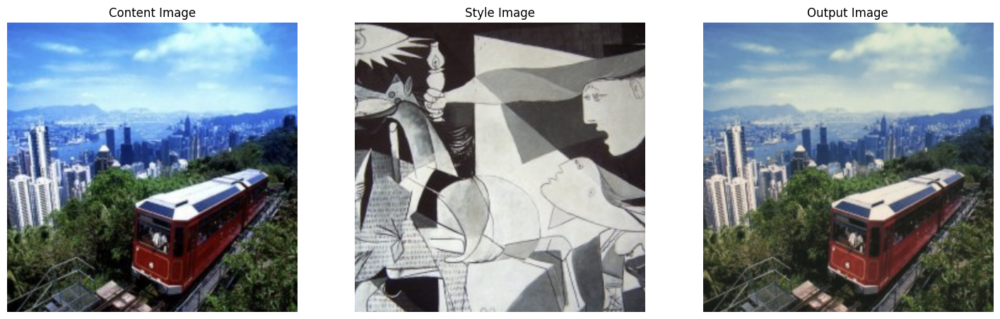

In [ ]:
transnet.load_state_dict(torch.load('model_trail_8.pth'))
output = transfer_style(transnet, content)

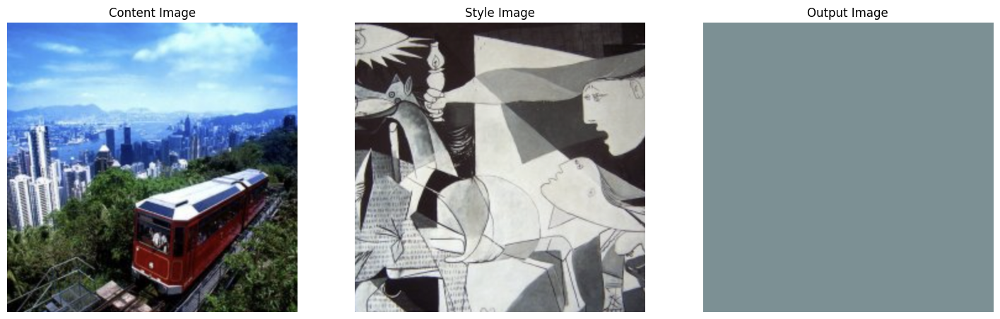

In [ ]:
transnet.load_state_dict(torch.load('model_trail_9.pth'))
output = transfer_style(transnet, content)

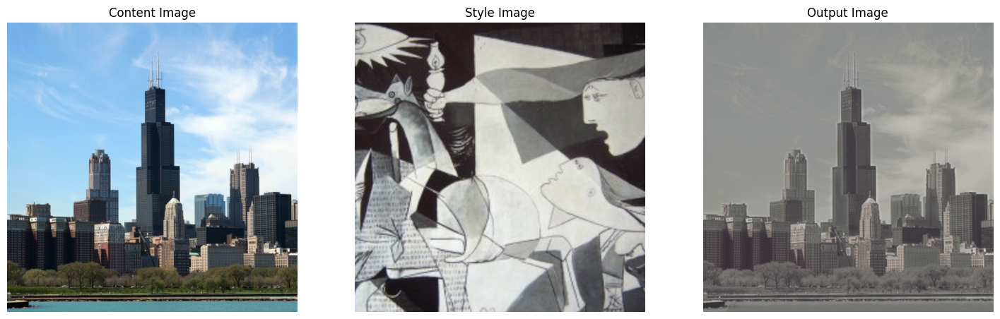

CPU times: user 2.58 s, sys: 962 ms, total: 3.54 s
Wall time: 7.21 s


In [ ]:
%%time

def transfer_style(transnet, content):
    transnet.eval()
    with torch.no_grad():
        output = draw(transnet(content), content_image, style_image)
    return output
transnet.load_state_dict(torch.load('model_epoch_1.pth'))
output = transfer_style(transnet, content)

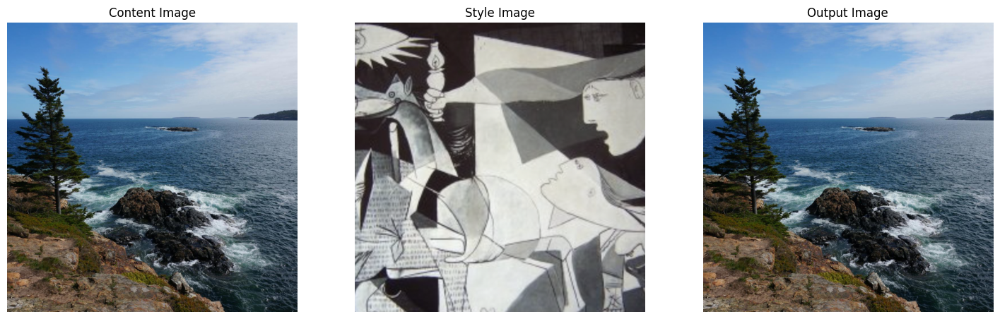

In [ ]:
files.upload()

# Open and prepare images
content_image2 = Image.open('maine.jpg')
content2 = prep(content_image2)

# Display images
_ = draw(content2, content_image2, style_image)


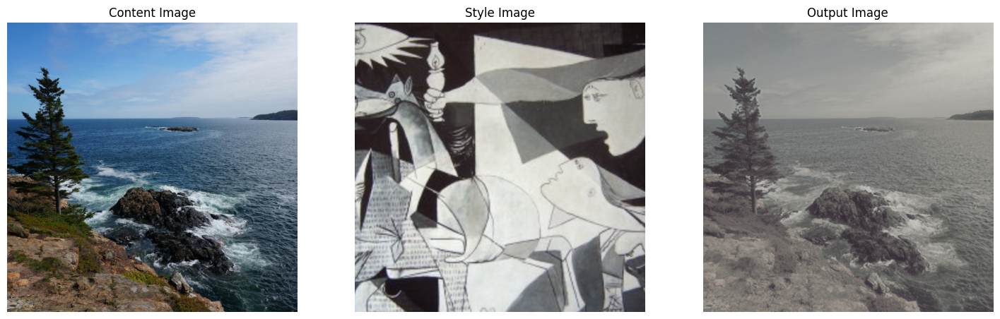

CPU times: user 1.43 s, sys: 265 ms, total: 1.7 s
Wall time: 1.34 s


In [ ]:
%%time
def transfer_style(transnet, content):
    transnet.eval()
    with torch.no_grad():
        output = draw(transnet(content), content_image2, style_image)
    return output
transnet.load_state_dict(torch.load('model_epoch_1.pth'))
output = transfer_style(transnet, content2)

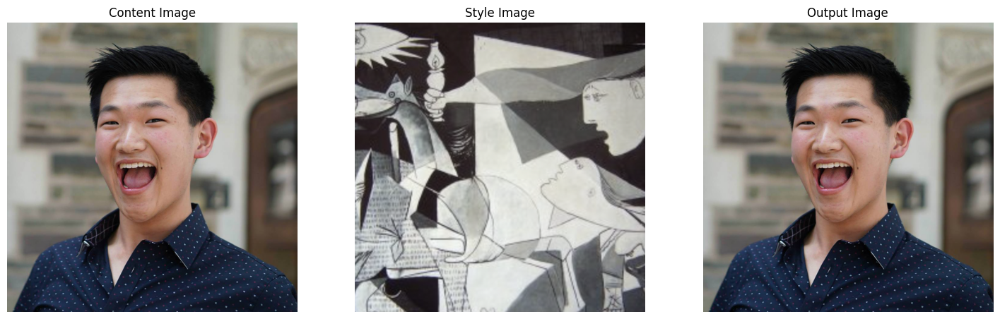

In [ ]:
files.upload()

# Open and prepare images
content_image3 = Image.open('dan.jpg')
content3= prep(content_image3)

# Display images
_ = draw(content3, content_image3, style_image)

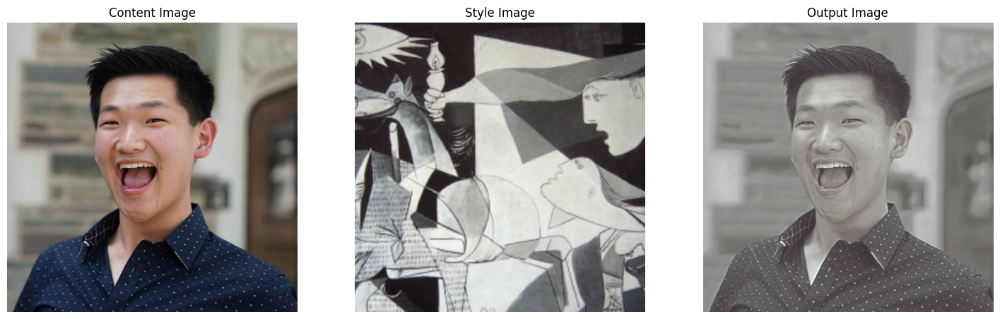

CPU times: user 1.45 s, sys: 234 ms, total: 1.68 s
Wall time: 1.34 s


In [ ]:
%%time
def transfer_style(transnet, content):
    transnet.eval()
    with torch.no_grad():
        output = draw(transnet(content), content_image3, style_image)
    return output
transnet.load_state_dict(torch.load('model_epoch_1.pth'))
output = transfer_style(transnet, content3)

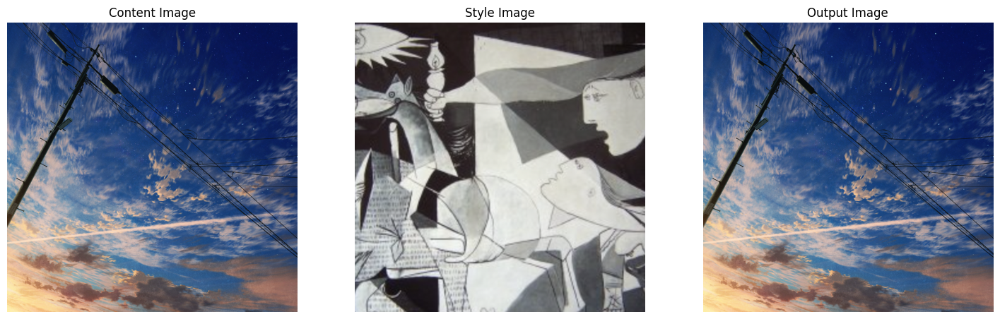

In [ ]:
files.upload()

# Open and prepare images
content_image4 = Image.open('sunset.jpeg')
content4= prep(content_image4)

# Display images
_ = draw(content4, content_image4, style_image)

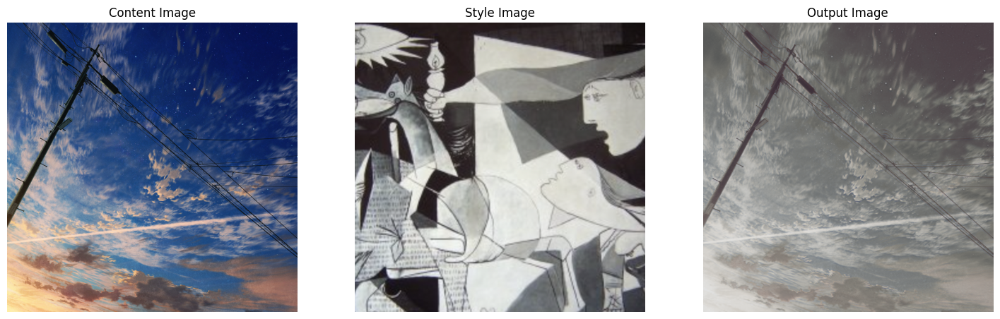

CPU times: user 1.5 s, sys: 240 ms, total: 1.74 s
Wall time: 1.4 s


In [ ]:
%%time
def transfer_style(transnet, content):
    transnet.eval()
    with torch.no_grad():
        output = draw(transnet(content), content_image4, style_image)
    return output
transnet.load_state_dict(torch.load('model_epoch_1.pth'))
output = transfer_style(transnet, content4)

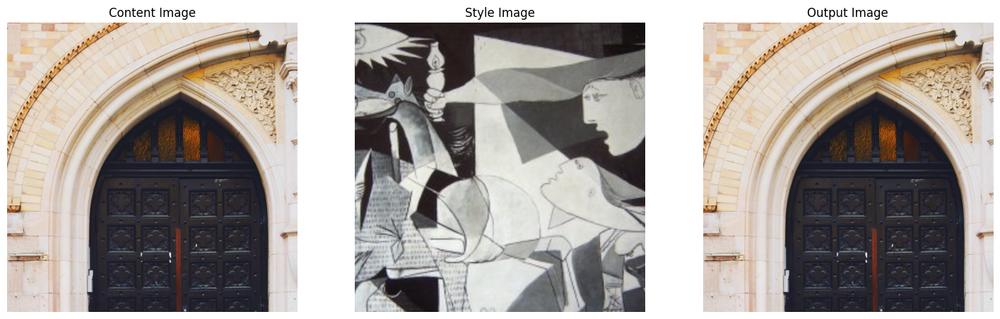

In [ ]:
files.upload()

# Open and prepare images
content_image5 = Image.open('amber.jpg')
content5= prep(content_image5)

# Display images
_ = draw(content5, content_image5, style_image)

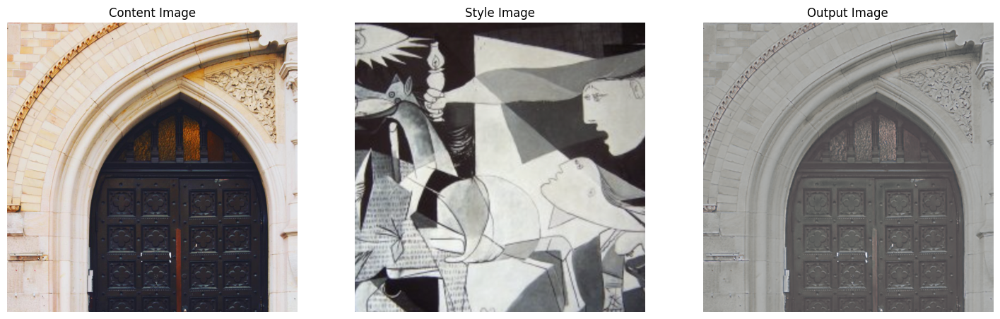

CPU times: user 1.46 s, sys: 248 ms, total: 1.7 s
Wall time: 1.36 s


In [ ]:
%%time
def transfer_style(transnet, content):
    transnet.eval()
    with torch.no_grad():
        output = draw(transnet(content), content_image5, style_image)
    return output
transnet.load_state_dict(torch.load('model_epoch_1.pth'))
output = transfer_style(transnet, content5)

In [ ]:
output.save('output.png')
files.download('output.png')